In [1]:
import os, glob, h5py, glob, sys, warnings, tqdm
import warnings
from timeit import default_timer as timer
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gp
from pyproj import Transformer
from pyproj import proj
import rasterio

sys.path.append(r'C:\Users\Sebastian\U\Spatial\Internship\Bodo_website\ICESat-2_SVDA-main\python')

#from SVDA_helper_functions import *
from SVDA_functions import *

In [2]:
# Data extraction from ATL03 product (HDF5 formatted files)
# This example uses only a single file, the code can also take a directory full of files

#The ATL03_20200320133708_12950614_003_01.h5 file is 4.7GB and is available at https://nsidc.org/data/ATL03
#ATL03_input_path = r'C:\Users\Sebastian\U\Spatial\ATL03\ATL03_20191030041540_05080506_005_01.h5'

# Output

#ATL03_output_path = r"D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\hdf_02"
ATL03_output_path = r"D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\big_hdf"

#Region of interest to be clipped from ATL08 file:
ROI_fname = r'C:\Users\Sebastian\U\Spatial\Internship\NSIDC\new_study_area\new_area-polygon.shp'
EPSG = 'epsg:7763'

In [3]:
ATL03_land_files = glob.glob(os.path.join(ATL03_output_path, 'ATL03_Land_*.hdf'))
ATL03_land_files.sort()

ATL03_list = []
for i in range(len(ATL03_land_files)):
    ATL03_df = pd.read_hdf(ATL03_land_files[i], mode='r')
    ATL03_df = ATL03_df.sort_values(by=['alongtrack'], ascending=True).reset_index()
    ATL03_list.append(ATL03_df)

# add a new column with normalized values starting from 0 and incrementing by 1
ATL03_list[21]['alongtrack_real'] = ((ATL03_list[21]["alongtrack"] - ATL03_list[21]["alongtrack"].min()) / (ATL03_list[21]["alongtrack"].max() - ATL03_list[21]["alongtrack"].min()) * len(ATL03_list[21])/1000)

#df = ATL03_list[21].reset_index(drop=True)

IndexError: list index out of range

In [79]:
ATL03_list[21]

,index,Latitude,Longitude,Along-track_Distance,Photon_Height,Land,Easting,Northing,crosstrack,alongtrack,alongtrack_real
0,6689099,31.941594,76.477904,12.636148,718.613464,0.0,915190.270613,1.021387e+06,-9263.351449,3.217930e+06,0.000000
1,6689100,31.941588,76.477910,13.176093,671.921692,4.0,915190.844262,1.021387e+06,-9263.977568,3.217931e+06,0.000795
2,6689102,31.941582,76.477909,13.892262,674.898438,4.0,915190.740453,1.021386e+06,-9263.938622,3.217932e+06,0.001832
3,6689103,31.941569,76.477908,15.303752,675.156250,4.0,915190.610608,1.021385e+06,-9263.937091,3.217933e+06,0.003877
4,6689104,31.941569,76.477908,15.308780,676.543030,4.0,915190.591688,1.021385e+06,-9263.918521,3.217933e+06,0.003884
...,...,...,...,...,...,...,...,...,...,...,...
162346,6851444,30.935539,76.363592,11.729467,210.557312,4.0,903347.652687,9.099525e+05,-7598.811775,3.329981e+06,162.345883
162347,6851445,30.935533,76.363592,12.435833,210.487076,4.0,903347.581670,9.099518e+05,-7598.804916,3.329981e+06,162.346907
162348,6851446,30.935527,76.363591,13.141478,210.323166,4.0,903347.511953,9.099511e+05,-7598.799320,3.329982e+06,162.347929
162349,6851447,30.935520,76.363590,13.848567,210.491287,4.0,903347.437678,9.099504e+05,-7598.789274,3.329983e+06,162.348953


In [25]:
ATL03_list[21]['Photon_Height'].describe()

count    162351.000000
mean        480.477733
std         367.198717
min         -99.023575
25%         292.934204
50%         438.195312
75%         581.805328
max        4216.420898
Name: Photon_Height, dtype: float64

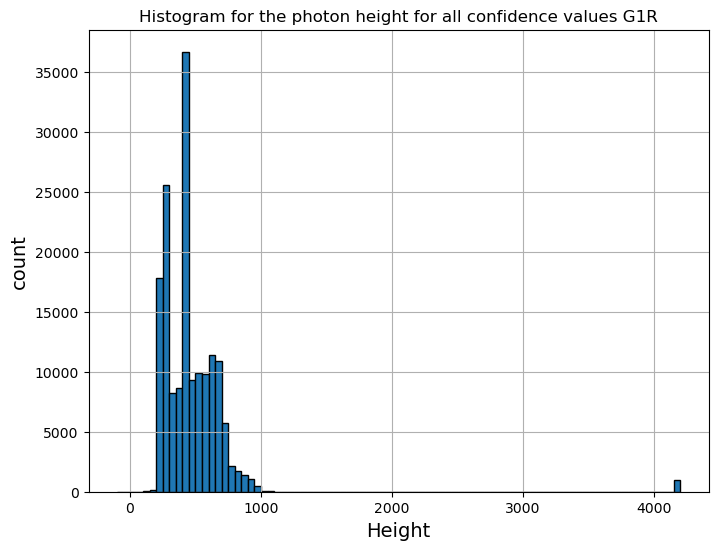

In [73]:
bins = np.arange(ATL03_list[21].Photon_Height.min(), ATL03_list[21].Photon_Height.max()+1, 50)

fig, ax1 = plt.subplots(1, 1, figsize=(8, 6))
ATL03_list[21].hist('Photon_Height', bins=bins, ec='k', lw=1, ax=ax1)
ax1.set_xlabel('Height', fontsize=14)
ax1.set_ylabel('count', fontsize=14)
ax1.set_title("Histogram for the photon height for all confidence values G1R")
plt.savefig("Histogram for the photon height for all flags G1R.jpg");

In [5]:
ATL03_list[21]['Photon_Height'][ATL03_list[21]['Land'] == 4].max()

1001.6142578125

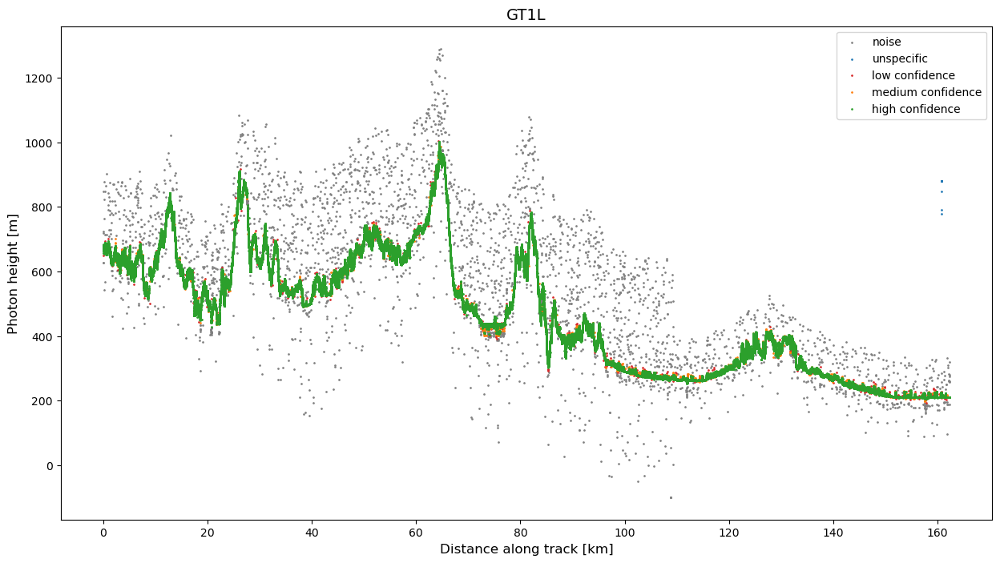

In [4]:
fig, ax = plt.subplots(1,1, figsize=(15,8))
#fig.set_dpi(600)
ax.scatter(ATL03_list[21]['alongtrack_real'][ATL03_list[21]['Land'] == 0],  ATL03_list[21]['Photon_Height'][ATL03_list[21]['Land'] == 0],  s=0.9, label='noise', c='gray')
ax.scatter(ATL03_list[21]['alongtrack_real'][ATL03_list[21]['Land'] == -1], ATL03_list[21]['Photon_Height'][ATL03_list[21]['Land'] == -1], s=0.9, label='unspecific', c='tab:blue')
ax.scatter(ATL03_list[21]['alongtrack_real'][ATL03_list[21]['Land'] == 2],  ATL03_list[21]['Photon_Height'][ATL03_list[21]['Land'] == 2],  s=0.9, label='low confidence', c='tab:red')
ax.scatter(ATL03_list[21]['alongtrack_real'][ATL03_list[21]['Land'] == 3],  ATL03_list[21]['Photon_Height'][ATL03_list[21]['Land'] == 3],  s=0.9, label='medium confidence', c='tab:orange')
ax.scatter(ATL03_list[21]['alongtrack_real'][ATL03_list[21]['Land'] == 4],  ATL03_list[21]['Photon_Height'][ATL03_list[21]['Land'] == 4],  s=0.9, label='high confidence', c='tab:green')
#plt.ylim([0, 5500])
ax.set_title("GT1L", fontsize=14)
ax.set_ylabel('Photon height [m]', fontsize=12)
ax.set_xlabel('Distance along track [km]', fontsize=12)
ax.legend(fontsize=10);
#plt.savefig('photon_dist.png', bbox_inches='tight')

In [4]:
# set up a x-z (distance along track, elevation) array to test suitability of methods on 

# create new df that includes all photons of ATL03 df swath 1 that have a confidence level of 2 or higher (low confidence or better)
ATL_conf = ATL03_list[21][ATL03_list[21]['Land'] >= 4]

# create numpy array from ATL_conf that includes only distance along track and photon height
xy = ATL_conf[['alongtrack_real', 'Photon_Height']].to_numpy()
xx = ATL_conf[['alongtrack_real', 'Photon_Height', "Latitude", "Longitude"]].to_numpy()

Text(0.5, 1.0, 'Ratio filtering for ground photon retrieval')

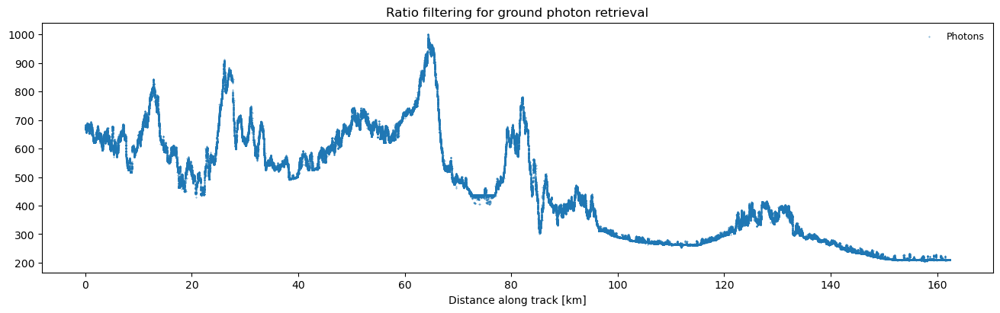

In [5]:
fig, ax = plt.subplots(figsize=(13,4), constrained_layout = True)
ax.scatter(xy[:,0], xy[:,1], s=0.1, label='Photons')
ax.legend(frameon=False, fontsize=9)
ax.set_xlabel('Distance along track [km]')
ax.set_title('Ratio filtering for ground photon retrieval')

CHECKING DATA

PLOTTING ON THE MAP

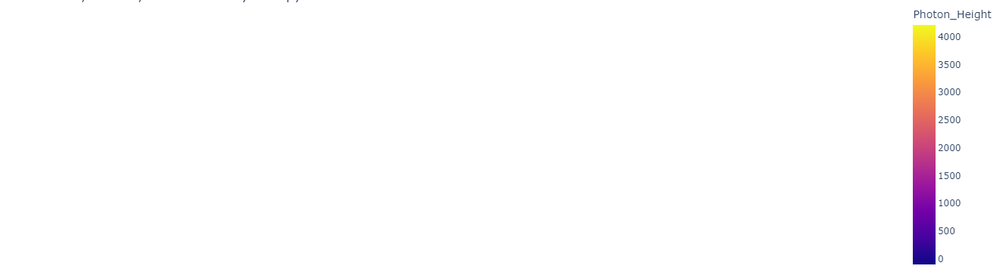

In [60]:
import json
f = open(r"C:\Users\Sebastian\U\Spatial\Internship\NSIDC\new_study_area\new_area.geojson")
area = json.load(f)

import plotly.express as px
fig = px.scatter_mapbox(ATL03_list[21], 
                        lat='Latitude', 
                        lon='Longitude',
                        color='Photon_Height', zoom=9)
fig.update_layout(
    mapbox = {
        'style': "white-bg",
        'zoom': 6, 'layers': [{
            'source': area,
            'type':'fill', 'below':'traces','color': 'grey', 'opacity' : 0.2}],
    })

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), title='Land, Ground, and Preliminary Canopy')
fig.show()

In [18]:
#import plotly.express as px
#fig = px.scatter_mapbox(ATL03_list[21], 
#                        lat='Latitude', 
#                        lon='Longitude',
#                        color='Photon_Height', zoom=9)
#fig.update_layout(mapbox_style="stamen-terrain")
#fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
#fig.show()

PANDASINTERPOLATIONS TRY

In [8]:
data = {'Longitude': xx[:,3], 'Latitude': xx[:,2], "Height" : xx[:,1], "alongtrack" : xy[:,0] }
df_regression = pd.DataFrame(data)
df_regression

,Longitude,Latitude,Height,alongtrack
0,76.477910,31.941588,671.921692,0.000795
1,76.477909,31.941582,674.898438,0.001832
2,76.477908,31.941569,675.156250,0.003877
3,76.477908,31.941569,676.543030,0.003884
4,76.477907,31.941563,677.123413,0.004909
...,...,...,...,...
156975,76.363592,30.935539,210.557312,162.345883
156976,76.363592,30.935533,210.487076,162.346907
156977,76.363591,30.935527,210.323166,162.347929
156978,76.363590,30.935520,210.491287,162.348953


In [10]:
# create new columns of interpolated values for each of three common methods
df_regression['Height_nn'] = df_regression["Height"].interpolate(method='nearest')
df_regression['Height_lin'] = df_regression["Height"].interpolate(method='linear')
df_regression['Height_cub'] = df_regression["Height"].interpolate(method='cubic')

print(df_regression.head())

   Longitude   Latitude      Height  alongtrack   Height_nn  Height_lin  \
0  76.477910  31.941588  671.921692    0.000795  671.921692  671.921692   
1  76.477909  31.941582  674.898438    0.001832  674.898438  674.898438   
2  76.477908  31.941569  675.156250    0.003877  675.156250  675.156250   
3  76.477908  31.941569  676.543030    0.003884  676.543030  676.543030   
4  76.477907  31.941563  677.123413    0.004909  677.123413  677.123413   

   Height_cub  
0  671.921692  
1  674.898438  
2  675.156250  
3  676.543030  
4  677.123413  


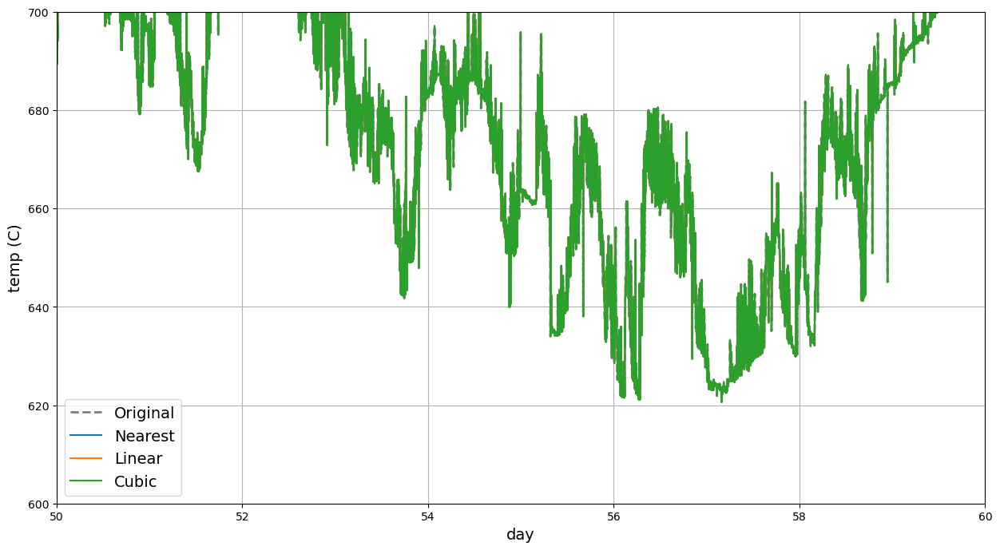

In [20]:
# plot the results
fig, ax = plt.subplots(figsize=(15, 8))

df_regression.plot(x="alongtrack", y='Height', marker='', ls='--', lw=2, 
            markersize=1, color='gray', ax=ax, label='Original')
df_regression.plot(x="alongtrack", y='Height_nn', marker='', ls='-', 
                markersize=1, ax=ax, label='Nearest')
df_regression.plot(x="alongtrack", y='Height_lin', marker='', ls='-', 
                 markersize=1, ax=ax, label='Linear')
df_regression.plot(x="alongtrack", y='Height_cub', marker='', ls='-', 
                 markersize=0.001, ax=ax, label='Cubic')

plt.axis([50, 60, 600, 700])
ax.set_xlabel('day', fontsize=14)
ax.set_ylabel('temp (C)', fontsize=14)
ax.legend(fontsize=14)
ax.grid()

POLINOMIAL FIT

In [7]:
src_geoid = rasterio.open(r'D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\output_COP30.tif')
array_geoid = src_geoid.read(1)
array_geoid[array_geoid==src_geoid.nodata] = np.nan

# define swath subset by start point and length (both in meters)
s = 0
l = 160000

# create new array that is subsetted by defined segment
xy = xy[(xy[:,0] >= s) & (xy[:,0] < s+l)]

# create new df: subset the confidence df by defined section
ATL_sub = ATL_conf[(ATL_conf['alongtrack_real'] >= s) & (ATL_conf['alongtrack_real'] < s+l)]

# create geodataframe from subsetted ATL03 df, add geometry column from photon's longitude and latitude in wgs84 crs
gdf = gp.GeoDataFrame(ATL_sub, geometry=gp.points_from_xy(ATL_sub.Longitude, ATL_sub.Latitude), crs=4326)
# write geometry to a list of coordinates
coord_list = [(x,y) for x,y in zip(gdf['geometry'].x , gdf['geometry'].y)]

# write values of DEMs at the coordinate in the list to a new column in the geodataframe
gdf['geoid_undul'] = [x for x in src_geoid.sample(coord_list)]
# change type to float
gdf['geoid_float'] = gdf.geoid_undul.astype(float)

In [12]:
from localreg import *

In [6]:
y0 = localreg(xy[:,0], xy[:,1], degree=1, kernel=rbf.rectangular, radius=1)
y1 = localreg(xy[:,0], xy[:,1], degree=1, kernel=rbf.triangular, radius=1)
y2 = localreg(xy[:,0], xy[:,1], degree=1, kernel=rbf.rectangular, radius=2)
y3 = localreg(xy[:,0], xy[:,1], degree=1, kernel=rbf.gaussian, radius=1)

In [ ]:
y0 = localreg(xy[:,0], xy[:,1], degree=0, kernel=rbf.rectangular, radius=0.5)

In [14]:
y1 = localreg(xy[:,0], xy[:,1], degree=1, kernel=rbf.rectangular, radius=0.3)

In [16]:
y2 = localreg(xy[:,0], xy[:,1], degree=2, kernel=rbf.rectangular, frac=0.01)#radius=2)

KeyboardInterrupt: 

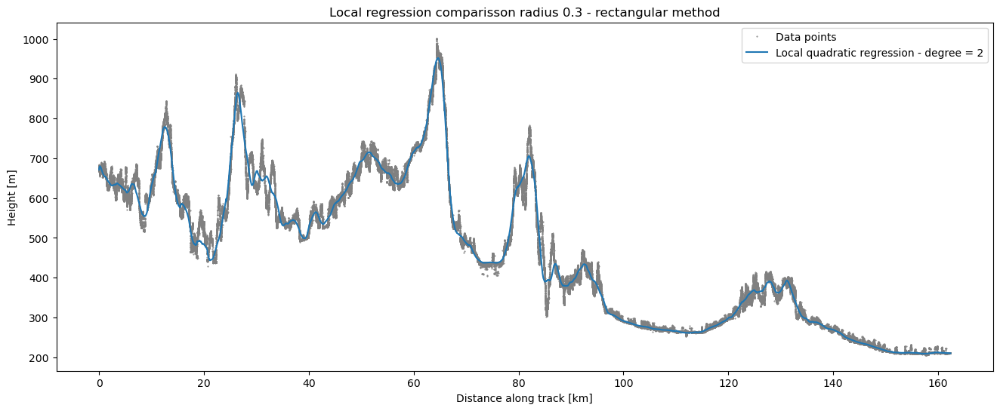

In [14]:
plt.figure(figsize=(16,6))
plt.plot(xy[:,0], xy[:,1], 'o', markersize=0.5, color='grey', label="Data points")
#plt.plot(x, yf, label='Ground truth ($\sin(x^2)$)')
#plt.plot(xy[:,0], y0, label='Moving average - degree = 0')
#plt.plot(xy[:,0], y1, label='Local linear regression - degree = 1')
plt.plot(xy[:,0], y2, label='Local quadratic regression - degree = 2')
#plt.margins(x=60, y=300)
plt.title("Local regression comparisson radius 0.3 - rectangular method")
plt.xlabel('Distance along track [km]')
plt.ylabel("Height [m]")
plt.legend()
#fig.set_dpi(300)
#plt.savefig("Local regression comparisson radius 0.3 rectangular.png")
plt.show()

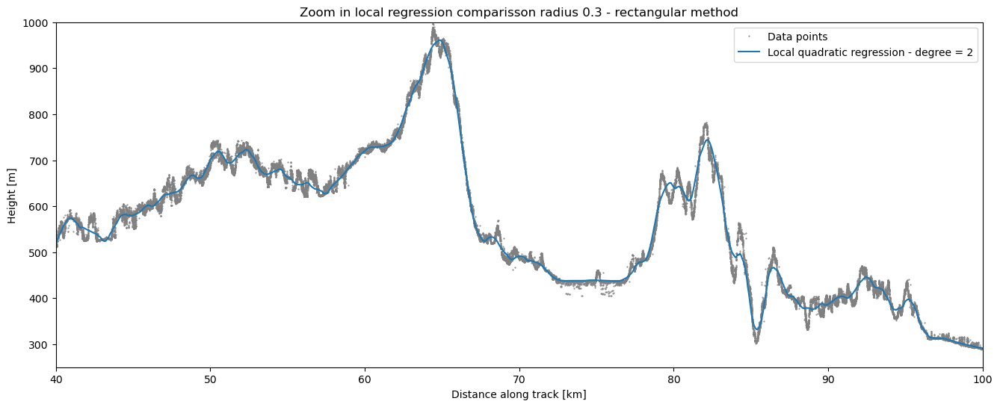

In [8]:
plt.figure(figsize=(16,6))
#fig.set_dpi(300)
plt.plot(xy[:,0], xy[:,1], 'o', markersize=0.5, color='grey', label="Data points")
#plt.plot(x, yf, label='Ground truth ($\sin(x^2)$)')
#plt.plot(xy[:,0], y0, label='Moving average - degree = 0')
#plt.plot(xy[:,0], y1, label='Local linear regression - degree = 1')
plt.plot(xy[:,0], y2, label='Local quadratic regression - degree = 2')
plt.axis([40, 100, 250, 1000])
plt.title("Zoom in local regression comparisson radius 0.3 - rectangular method")
plt.xlabel('Distance along track [km]')
plt.ylabel("Height [m]")
plt.legend()
#plt.savefig("Zoom in local regression comparisson radius 0.3 - rectangular method.png")
plt.show()

SLOPE FINDING

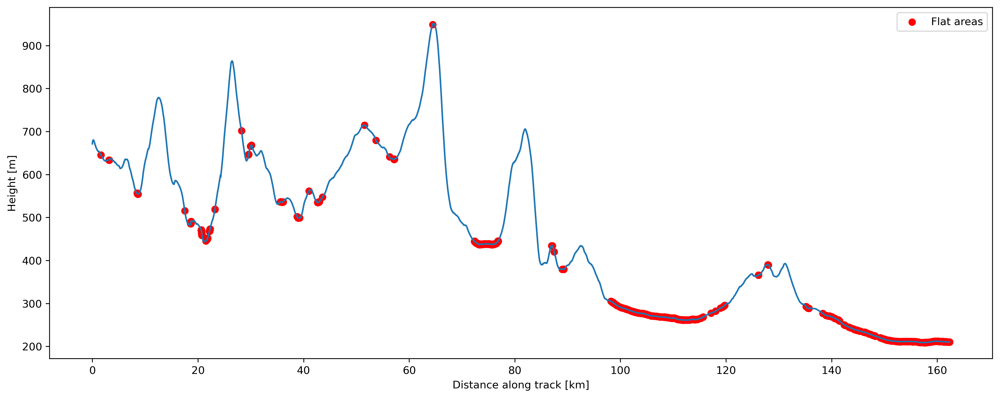

In [18]:
# Generate a sample topographic curve
x = xy[:,0]
y = y2

# Calculate the slope at each point on the curve using numerical differentiation
dx = x[1] - x[0]
dydx = np.gradient(y, dx)

# Identify points where the slope is close to 0
tolerance = 0.001
flat_points = np.where(np.abs(dydx) < tolerance)[0]

# Plot the results
fig, ax = plt.subplots(figsize=(16,6))
ax.plot(x, y)
ax.scatter(x[flat_points], y[flat_points], color='red', label='Flat areas')
#plt.axis([60, 90, 250, 1000])
plt.xlabel('Distance along track [km]')
plt.ylabel("Height [m]")
ax.legend()
fig.set_dpi(300)
#plt.savefig("Areas with slope 0.001.png")
plt.show()

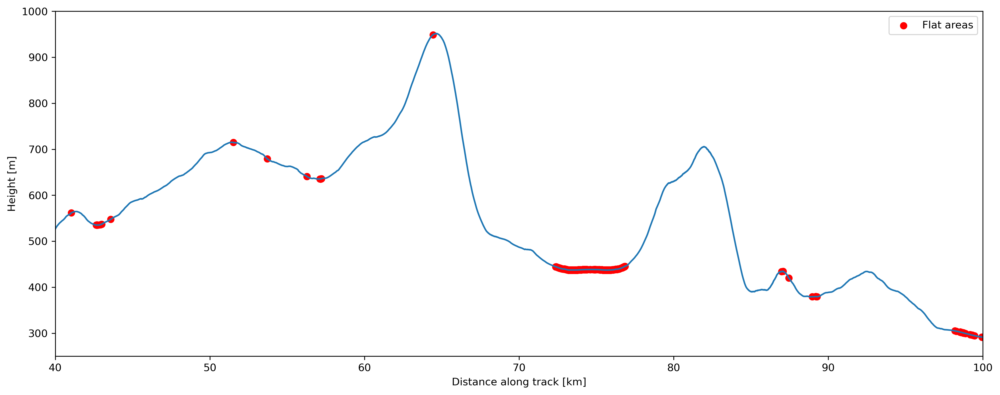

In [12]:

# Generate a sample topographic curve
x = xy[:,0]
y = y2

# Calculate the slope at each point on the curve using numerical differentiation
dx = x[1] - x[0]
dydx = np.gradient(y, dx)

# Identify points where the slope is close to 0
tolerance = 0.001
flat_points = np.where(np.abs(dydx) < tolerance)[0]

# Plot the results
fig, ax = plt.subplots(figsize=(16,6))
ax.plot(x, y)
ax.scatter(x[flat_points], y[flat_points], color='red', label='Flat areas')
plt.xlabel('Distance along track [km]')
plt.ylabel("Height [m]")
plt.axis([40, 100, 250, 1000])
ax.legend()
fig.set_dpi(300)

#plt.savefig("Zoom areas with slope 0.001.png")
plt.show()


COMPARISSON WITH DEM

In [5]:
# Copernicus GLO-30 DEM
src_glo30 = rasterio.open(r'D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\output_COP30.tif')
array_glo30 = src_glo30.read(1)
array_glo30[array_glo30==src_glo30.nodata] = np.nan

# JAX 3m DEM
src_qdt3 = rasterio.open(r'D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\N031E076\ALPSMLC30_N031E076_DSM.tif')
array_qdt3 = src_qdt3.read(1, masked=True).astype(float)
array_qdt3[array_qdt3==src_qdt3.nodata] = np.nan

# SRTM Sector 51 5 m DEM
src_salta5 = rasterio.open(r'D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\n31_e076_1arc_v3.tif')
array_salta5 = src_salta5.read(1).astype(float)
array_salta5[array_salta5==src_salta5.nodata] = np.nan

# Geoid (to correct differences in vertical datum)
src_geoid = rasterio.open(r'D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\us_nga_egm2008_1.tif')
array_geoid = src_geoid.read(1)
array_geoid[array_geoid==src_geoid.nodata] = np.nan

In [6]:
s = 0
l = 2000

# create new array that is subsetted by defined segment
xy = xy[(xy[:,0] >= s) & (xy[:,0] < s+l)]

# create new df: subset the confidence df by defined section
ATL_sub = ATL_conf[(ATL_conf['alongtrack_real'] >= s) & (ATL_conf['alongtrack_real'] < s+l)]

# create geodataframe from subsetted ATL03 df, add geometry column from photon's longitude and latitude in wgs84 crs
gdf = gp.GeoDataFrame(ATL_sub, geometry=gp.points_from_xy(ATL_sub.Longitude, ATL_sub.Latitude), crs=4326)
# write geometry to a list of coordinates
coord_list = [(x,y) for x,y in zip(gdf['geometry'].x , gdf['geometry'].y)]

# write values of DEMs at the coordinate in the list to a new column in the geodataframe
gdf['geoid_undul'] = [x for x in src_geoid.sample(coord_list)]
gdf['geoid_float'] = gdf.geoid_undul.astype(float)

gdf['glo30_height'] = [x for x in src_glo30.sample(coord_list)]
gdf['glo30_float'] = gdf.glo30_height.astype(float)
# fix difference between height crs (geoid undulation)
gdf['glo30_ell'] = np.add(gdf.glo30_float, gdf.geoid_float).astype(float)

gdf_swath1 = gdf.drop(['geoid_undul', 'glo30_height', 'glo30_float'], axis=1)

gdf['qdt3_height'] = [x for x in src_qdt3.sample(coord_list)]
gdf['qdt3_float'] = gdf.qdt3_height.astype(float)
    # nodata value is converted to nan to not influence results
#gdf = gdf.replace(src_qdt3.nodata, np.nan)
    
gdf['salta5_height'] = [x for x in src_salta5.sample(coord_list)]
gdf['salta5_float'] = gdf.salta5_height.astype(float)
#gdf = gdf.replace(src_salta5.nodata, np.nan)
gdf['salta5_float'] = np.add(gdf.salta5_float, gdf.geoid_float)
    
    # salta DEM has some areas where difference to GLO-30 is very large (up to 250 meters) --> set those values to nan
#gdf.salta5_float[(gdf.glo30_ell - gdf.salta5_float) > 30] = np.nan
    
    # new dataframe where initial sample columns are dropped (float columns remain)
gdf2 = gdf.drop(['geoid_undul', 'glo30_height', 'glo30_float', 'qdt3_height', 'salta5_height'], axis=1)

In [8]:
gdf2

,index,Latitude,Longitude,Along-track_Distance,Photon_Height,Land,Easting,Northing,crosstrack,alongtrack,alongtrack_real,geometry,geoid_float,glo30_ell,qdt3_float,salta5_float
1,6689100,31.941588,76.477910,13.176093,671.921692,4.0,915190.844262,1.021387e+06,-9263.977568,3.217931e+06,0.000795,POINT (76.47791 31.94159),-40.361244,674.846947,713.0,675.638756
2,6689102,31.941582,76.477909,13.892262,674.898438,4.0,915190.740453,1.021386e+06,-9263.938622,3.217932e+06,0.001832,POINT (76.47791 31.94158),-40.361244,674.846947,713.0,675.638756
3,6689103,31.941569,76.477908,15.303752,675.156250,4.0,915190.610608,1.021385e+06,-9263.937091,3.217933e+06,0.003877,POINT (76.47791 31.94157),-40.361244,674.846947,713.0,675.638756
4,6689104,31.941569,76.477908,15.308780,676.543030,4.0,915190.591688,1.021385e+06,-9263.918521,3.217933e+06,0.003884,POINT (76.47791 31.94157),-40.361244,674.846947,713.0,675.638756
5,6689106,31.941563,76.477907,16.016321,677.123413,4.0,915190.520652,1.021384e+06,-9263.911755,3.217934e+06,0.004909,POINT (76.47791 31.94156),-40.361244,674.846947,713.0,675.638756
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162346,6851444,30.935539,76.363592,11.729467,210.557312,4.0,903347.652687,9.099525e+05,-7598.811775,3.329981e+06,162.345883,POINT (76.36359 30.93554),-46.882889,210.155624,0.0,-32813.882889
162347,6851445,30.935533,76.363592,12.435833,210.487076,4.0,903347.581670,9.099518e+05,-7598.804916,3.329981e+06,162.346907,POINT (76.36359 30.93553),-46.882889,210.155624,0.0,-32813.882889
162348,6851446,30.935527,76.363591,13.141478,210.323166,4.0,903347.511953,9.099511e+05,-7598.799320,3.329982e+06,162.347929,POINT (76.36359 30.93553),-46.882889,210.155624,0.0,-32813.882889
162349,6851447,30.935520,76.363590,13.848567,210.491287,4.0,903347.437678,9.099504e+05,-7598.789274,3.329983e+06,162.348953,POINT (76.36359 30.93552),-46.882889,210.155624,0.0,-32813.882889


SCATTER PLOTS

(50.0, 60.0, 600.0, 800.0)

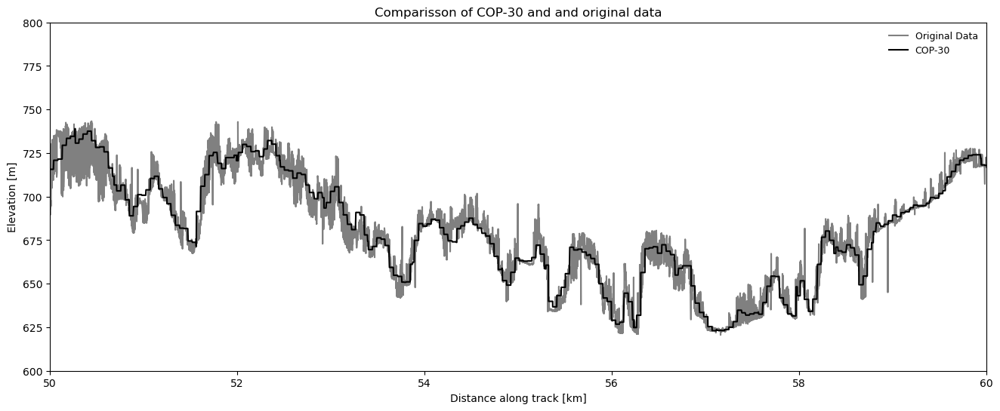

In [14]:
x = gdf2["Photon_Height"]
y = gdf2["glo30_ell"]

res = stats.linregress(x, y)
B_est, A_est, r, p, se_B, se_A = res.slope, res.intercept, res.rvalue, res.pvalue, res.stderr, res.intercept_stderr

y_est = A_est + B_est * x

resid = y - y_est

r2 = r**2
n = x.size
ssr = np.sum((resid) ** 2)
rmse = np.sqrt(ssr / (n - 2))

#print(f"{res.pvalue:.1e}")
fig, ax = plt.subplots(1,1,figsize=(16,6))
#fig.set_dpi(300)
ax.plot(gdf2.alongtrack_real, gdf2.Photon_Height, color='grey', label="Original Data")
ax.plot(gdf2.alongtrack_real, gdf2.glo30_ell, color='k', label='COP-30')
ax.set_title('Comparisson of COP-30 and and original data')
ax.legend(frameon=False, fontsize=9)
ax.set_ylabel('Elevation [m]')
ax.set_xlabel('Distance along track [km]')
plt.axis([50, 60, 600, 800])

In [7]:
x = gdf2.Photon_Height
y = [gdf2.glo30_ell, gdf2.qdt3_float, gdf2.salta5_float]
names_DEM = ["Copernicus", "JAXA", "SRTM"]
r2_gdem = []
yest_gdem = []
ssr_gdem = []
rmse_gdem = []
best = []
aest = []
seb = []
sea = []
for i in range(len(y)):
    res = stats.linregress(x, y[i])
    B_est, A_est, r, p, se_B, se_A = res.slope, res.intercept, res.rvalue, res.pvalue, res.stderr, res.intercept_stderr
    y_est = A_est + B_est * x
    resid = y[i] - y_est
    r2 = r**2
    n = x.size
    ssr = np.sum((resid) ** 2)
    rmse = np.sqrt(ssr / (n - 2))
    
    best.append(B_est)
    aest.append(A_est)
    seb.append(se_B)
    sea.append(se_A)
    yest_gdem.append(y_est)
    r2_gdem.append(r2)
    ssr_gdem.append(ssr)
    rmse_gdem.append(rmse)

In [8]:
# set the confidence level, 0.05 is 95%
alpha = 0.05

# use scipy to look up the t-value for given parameters
t = stats.t.ppf(1 - (alpha/2), n - 2)

print("critical t-value at {:.1f}% confidence with {} degrees of freedom: {:.3f}"\
      .format(100*(1 - alpha), n - 2, t))
print("t-statistic for slope (number of standard errors that the slope differs from 0 slope): {:.3f}"\
      .format(r * np.sqrt(n - 2) / np.sqrt(1 - r**2)))

critical t-value at 95.0% confidence with 156978 degrees of freedom: 1.960
t-statistic for slope (number of standard errors that the slope differs from 0 slope): 171.080


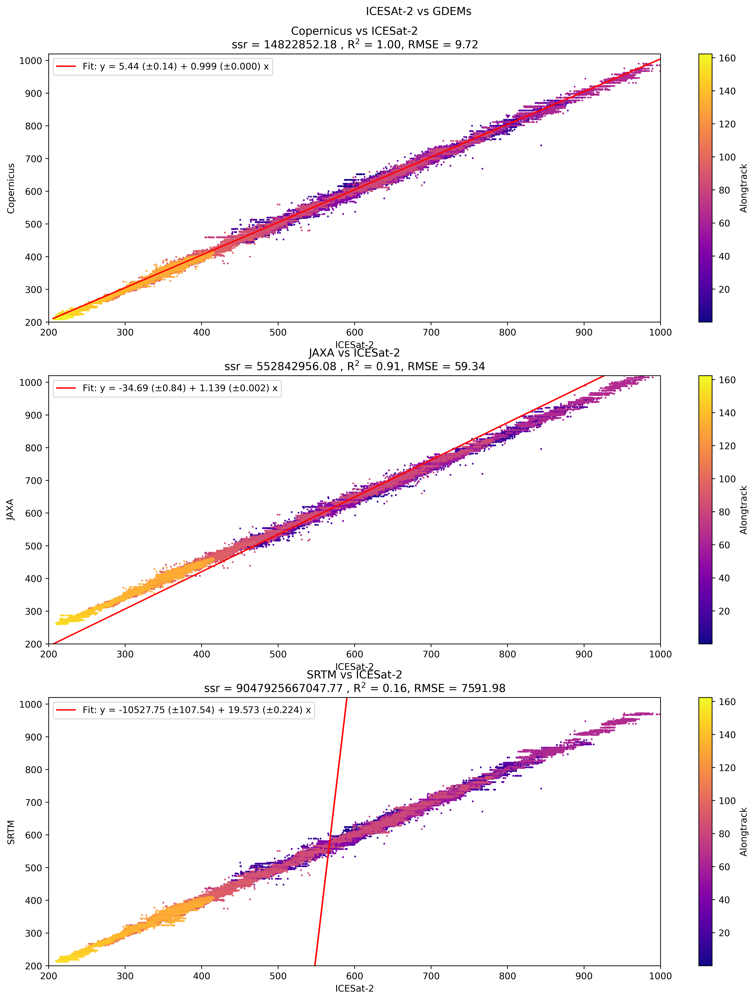

In [9]:
fig, axes = plt.subplots(3, 1, figsize=(15, 18))
ax1, ax2, ax3 = axes.flatten()
fig.set_dpi(500)
fig.suptitle("ICESAt-2 vs GDEMs", y=0.92)

a = ax1.scatter(x, y[0], c=gdf2.alongtrack_real, cmap='plasma', s=1)
b = ax2.scatter(x, y[1], c=gdf2.alongtrack_real, cmap='plasma', s=1)
c = ax3.scatter(x, y[2], c=gdf2.alongtrack_real, cmap='plasma', s=1)
    
ax1.set_title("Copernicus vs ICESat-2\nssr = {:0.2f} , R$^2$ = {:0.2f}, RMSE = {:0.2f}".format(ssr_gdem[0], r2_gdem[0], rmse_gdem[0]))
ax2.set_title("JAXA vs ICESat-2\nssr = {:0.2f} , R$^2$ = {:0.2f}, RMSE = {:0.2f}".format(ssr_gdem[1], r2_gdem[1], rmse_gdem[1]))
ax3.set_title("SRTM vs ICESat-2\nssr = {:0.2f} , R$^2$ = {:0.2f}, RMSE = {:0.2f}".format(ssr_gdem[2], r2_gdem[2], rmse_gdem[2]))

ax1.plot(x, yest_gdem[0], 'r-', 
         label='Fit: y = {:0.2f} ($\pm${:0.2f}) + {:0.3f} ($\pm${:0.3f}) x'.format(aest[0], t * sea[0], best[0], t * seb[0]))
ax2.plot(x, yest_gdem[1], 'r-', 
         label='Fit: y = {:0.2f} ($\pm${:0.2f}) + {:0.3f} ($\pm${:0.3f}) x'.format(aest[1], t * sea[1], best[1], t * seb[1]))
ax3.plot(x, yest_gdem[2], 'r-', 
         label='Fit: y = {:0.2f} ($\pm${:0.2f}) + {:0.3f} ($\pm${:0.3f}) x'.format(aest[2], t * sea[2], best[2], t * seb[2]))
   
cbar = plt.colorbar(a, label="Alongtrack")
ax1.set_xlabel('ICESat-2')
ax1.set_ylabel('Copernicus')
ax1.axis([200, 1000, 200, 1020])
ax1.legend()

cbar = plt.colorbar(b, label="Alongtrack")
ax2.set_xlabel('ICESat-2')
ax2.set_ylabel('JAXA')
ax2.axis([200, 1000, 200, 1020])
ax2.legend()

cbar = plt.colorbar(c, label="Alongtrack")
ax3.set_xlabel('ICESat-2')
ax3.set_ylabel('SRTM')
ax3.axis([200, 1000, 200, 1020])
ax3.legend()

#plt.savefig("ICESat-2 vs Global DEMs.jpg")

ValueError: x and y must be the same size

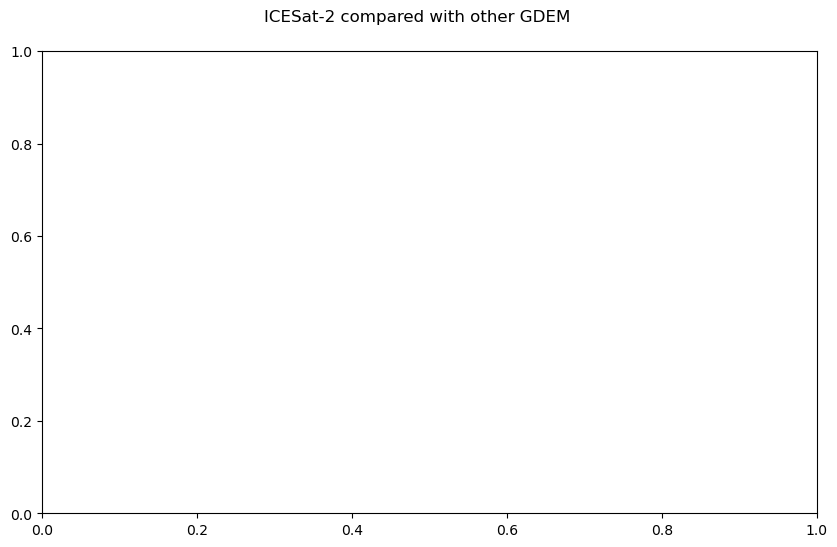

In [12]:
fig, axes = plt.subplots(figsize=(10, 6))
fig.suptitle("ICESat-2 compared with other GDEM", y=0.95)

a = ax1.scatter(x, y, c=gdf2.alongtrack_real, cmap='plasma', s=1)
cbar = plt.colorbar(a)
ax1.set_xlabel('ICESat-2')
ax1.set_ylabel('Copernicus')
ax1.plot(x, y_est, 'r-', 
         label='Fit: y = {:0.2f} ($\pm${:0.2f}) + {:0.2f} ($\pm${:0.2f}) x'.format(A_est, t * se_A, B_est, t * se_B))

ax1.set_title('r = {:0.2f}, R$^2$ = {:0.2f}, RMSE = {:0.2f}, p-val = {:.2e}'.format(r, r**2, rmse, p))

#ax1.set_xlabel('year', fontsize=12)
#ax1.set_ylabel('mean summer temp (C)', fontsize=12)
ax1.legend(fontsize=12)
ax1.grid(lw=0.4)

(-2.0, 170.0, 200.0, 1020.0)

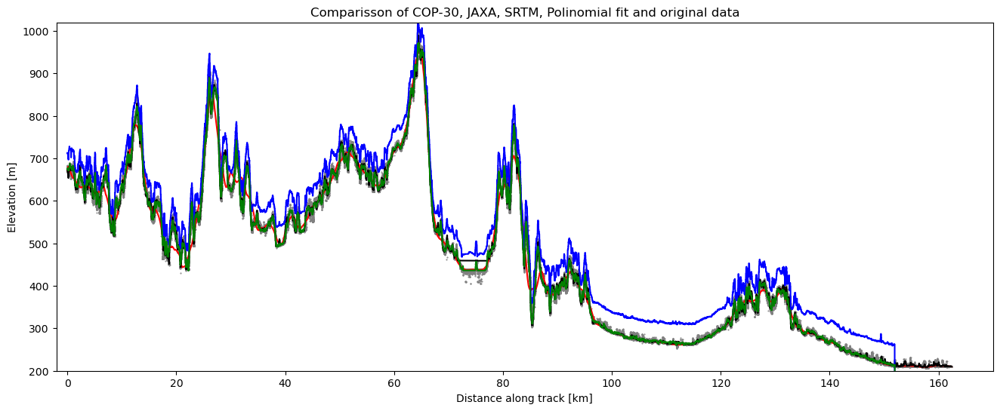

In [10]:
fig, ax = plt.subplots(1,1,figsize=(16,6))
#fig.set_dpi(300)
ax.plot(xy[:,0], xy[:,1], 'o', markersize=0.5, color='grey', label="Original Data")
ax.plot(xy[:,0], y2, color='red', label='Polinomial Fit')
ax.plot(gdf2.alongtrack_real, gdf2.glo30_ell, color='k', label='COP-30')
ax.plot(gdf2.alongtrack_real, gdf2.qdt3_float, color='blue', label='JAXA')
ax.plot(gdf2.alongtrack_real, gdf2.salta5_float, color='green', label='SRTM')
ax.set_title('Comparisson of COP-30, JAXA, SRTM, Polinomial fit and original data')
#ax.legend(frameon=False, fontsize=9)
ax.set_ylabel('Elevation [m]')
ax.set_xlabel('Distance along track [km]')
plt.axis([-2, 170, 200, 1020])
#plt.savefig("Comparisson of COP-30, JAXA, SRTM, Polinomial fit and original data.jpg")

Text(0.5, 0, 'Distance along track [km]')

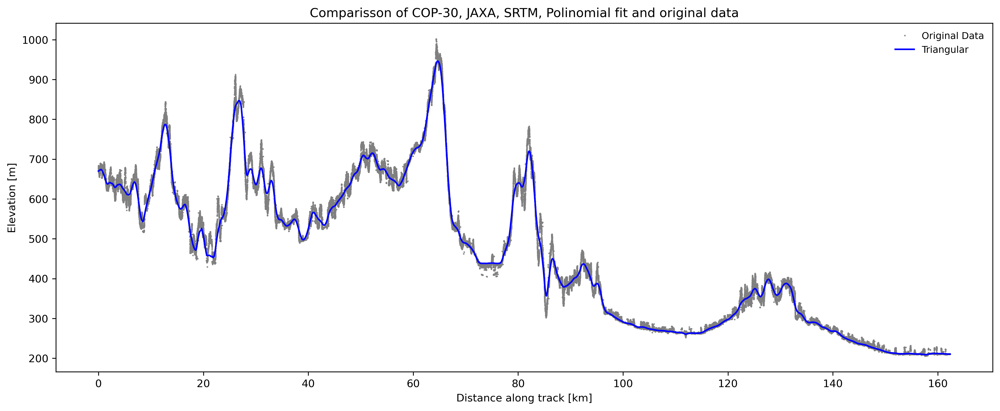

In [18]:
fig, ax = plt.subplots(1,1,figsize=(16,6))
fig.set_dpi(300)
ax.plot(xy[:,0], xy[:,1], 'o', markersize=0.5, color='grey', label="Original Data")
#ax.plot(xy[:,0], y0, color='red', label='Rectangular R=1')
ax.plot(xy[:,0], y1, color='blue', label='Triangular')
#ax.plot(xy[:,0], y2, color='k', label='Rectangular R=2')
#ax.plot(xy[:,0], y3, color='green', label='Gaussian')
#ax.plot(gdf2.alongtrack_real, gdf2.glo30_ell, color='k', label='COP-30')
#ax.plot(gdf2.alongtrack_real, gdf2.qdt3_float, color='blue', label='JAXA')
#ax.plot(gdf2.alongtrack_real, gdf2.salta5_float, color='green', label='SRTM')
ax.set_title('Comparisson of COP-30, JAXA, SRTM, Polinomial fit and original data')
ax.legend(frameon=False, fontsize=9)
ax.set_ylabel('Elevation [m]')
ax.set_xlabel('Distance along track [km]')
#plt.axis([50, 60, 600, 800])
#plt.savefig("Zoom Comparisson of COP-30, JAXA, SRTM, Polinomial fit and original data.jpg")

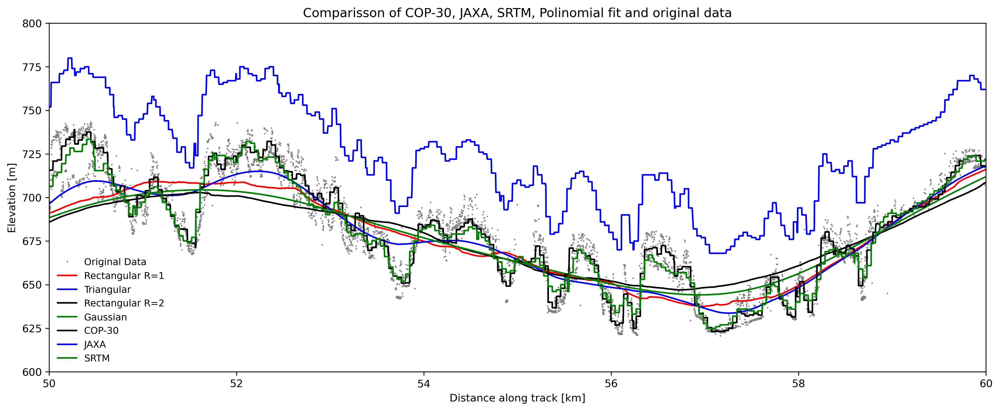

In [16]:
fig, ax = plt.subplots(1,1,figsize=(16,6))
fig.set_dpi(300)
ax.plot(xy[:,0], xy[:,1], 'o', markersize=0.5, color='grey', label="Original Data")
ax.plot(xy[:,0], y0, color='red', label='Rectangular R=1')
ax.plot(xy[:,0], y1, color='blue', label='Triangular')
ax.plot(xy[:,0], y2, color='k', label='Rectangular R=2')
ax.plot(xy[:,0], y3, color='green', label='Gaussian')
ax.plot(gdf2.alongtrack_real, gdf2.glo30_ell, color='k', label='COP-30')
ax.plot(gdf2.alongtrack_real, gdf2.qdt3_float, color='blue', label='JAXA')
ax.plot(gdf2.alongtrack_real, gdf2.salta5_float, color='green', label='SRTM')
ax.set_title('Comparisson of COP-30, JAXA, SRTM, Polinomial fit and original data')
ax.legend(frameon=False, fontsize=9)
ax.set_ylabel('Elevation [m]')
ax.set_xlabel('Distance along track [km]')
plt.axis([50, 60, 600, 800])
plt.savefig("Zoom Comparisson of REctangular, Gaussian, triangular, COP-30, JAXA, SRTM, Polinomial fit and original data.jpg")

In [15]:
from sklearn.metrics import mean_squared_error

# ICESat-2 elevation values
icesat_elevations = xy[:,1]

# Corresponding DEMs elevation values
#dems_elevations = y2
dems_elevation = [y0, y1, y2, y3, gdf2.glo30_ell, gdf2.qdt3_float, gdf2.salta5_float]
dems_names = ["Rectangular R=1", 'Triangular', 'Rectangular R=2', 'Gaussian', "Copernicus", "JAXA", "SRTM"]
# Calculate the squared residuals
#residuals = (icesat_elevations - dems_elevations) ** 2

# Calculate the mean squared residuals
#mse = np.mean(residuals)

# Calculate the RMSE
#rmse = np.sqrt(mse)
all_resid = []
for i in range(len(dems_elevation)):
    residuals = (icesat_elevations - dems_elevation[i]) ** 2
    mse = np.mean(residuals)
    rmse = np.sqrt(mean_squared_error(icesat_elevations, dems_elevation[i]))
    all_resid.append(residuals)
    
    print(f'{dems_names[i]}')
    #print("Residuals", residuals)
    print("MSR", mse)
    print("RMSE:", rmse)
    print()

Rectangular R=1
MSR 402.55564461513444
RMSE: 20.0637893882271

Triangular
MSR 211.16543969027825
RMSE: 14.531532599498178

Rectangular R=2
MSR 802.7622444579964
RMSE: 28.33305921459941

Gaussian
MSR 565.9594776973906
RMSE: 23.789902851785474

Copernicus
MSR 119.07259606974861
RMSE: 10.912039042715556

JAXA
MSR 4828.660743929447
RMSE: 69.48856556246824

SRTM
MSR 72073141.13664018
RMSE: 8489.590163054998



In [47]:
len(all_resid)

4

In [ ]:
# print RMSE for all beams and polyfit/LOWESS/Kalman

for i in range(len(ATL03_list)):
    gdf = gp.read_file(f'../data/swaths/swath{i}.shp')
    xy = gdf[['alongtrack', 'Photon_Hei']].to_numpy()
    pfit_smooth = gdf.pfit_smoot
    xy_lowess = lowess(xy[:,1], xy[:,0], frac=1./(len(xy)/100))
    observations = xy[:,1]
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", category=DeprecationWarning)
        kf = KalmanFilter(initial_state_mean = np.array([xy[0,1],0]))
        kf_pred, _ = kf.smooth(observations)
    kf_smooth = gaussian_filter(kf_pred[:,0], sigma=5)
    

    print(f'{tracknames[i]}')
    print(f'Polyfit: RSME = {np.sqrt(np.sum((xy[:,1]-pfit_smooth)**2)/len(xy)):.2f} m')
    print(f'LOWESS: RSME = {np.sqrt(np.sum((xy[:,1]-xy_lowess[:,1])**2)/len(xy)):.2f} m')
    print(f'Kalman: RSME = {np.sqrt(np.sum((xy[:,1]-kf_smooth)**2)/len(xy)):.2f} m\n')

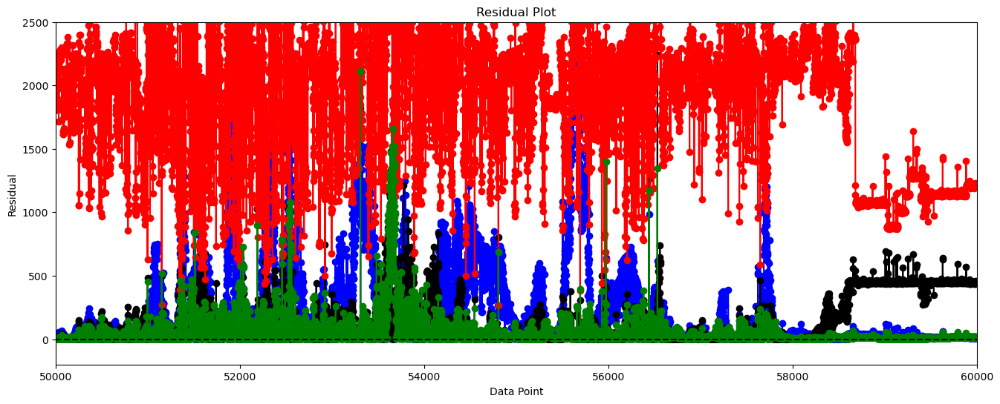

In [49]:
x = np.arange(len(icesat_elevations))

colors = ["blue", "k", "red", "green"]
fig, ax = plt.subplots(1,1,figsize=(16,6))
for i in range(len(all_resid)):
    plt.plot(x, all_resid[i], marker='o', color = colors[i])
plt.axhline(y=0, color='black', linestyle='--')
plt.axis([50000, 60000, -200, 2500])
plt.xlabel('Data Point')
plt.ylabel('Residual')
plt.title('Residual Plot')
plt.show()

Text(0.5, 0, 'Distance along track [km]')

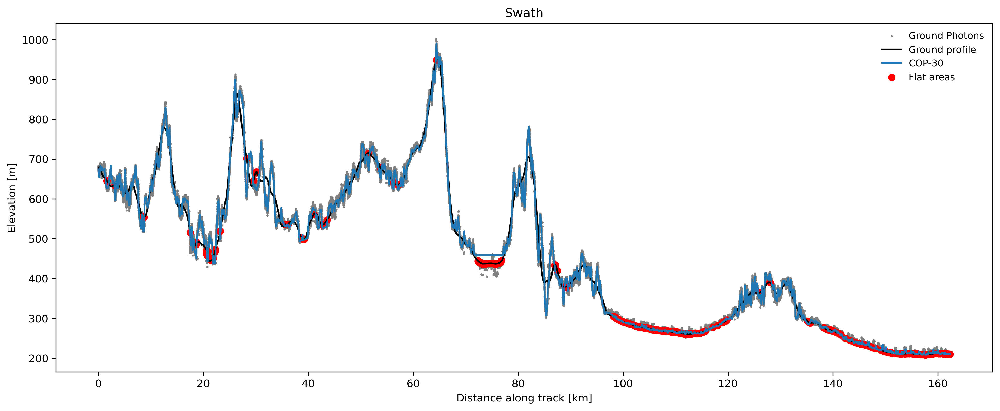

In [14]:
fig, ax = plt.subplots(1,1,figsize=(16,6))
fig.set_dpi(300)
ax.scatter(gdf.alongtrack_real, gdf.Photon_Height, s=1, color='grey', label='Ground Photons')
ax.plot(xy[:,0], y2, color='k', label='Ground profile')
ax.plot(gdf.alongtrack_real, gdf.glo30_ell, label='COP-30')
ax.scatter(x[flat_points], y[flat_points], color='red', label='Flat areas')
ax.set_title('Swath')
ax.legend(frameon=False, fontsize=9)
ax.set_ylabel('Elevation [m]')
ax.set_xlabel('Distance along track [km]')
#plt.savefig(r'D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\figures\DEMs_comparisson.png', bbox_inches='tight')

Text(0.5, 0, 'Distance along track [km]')

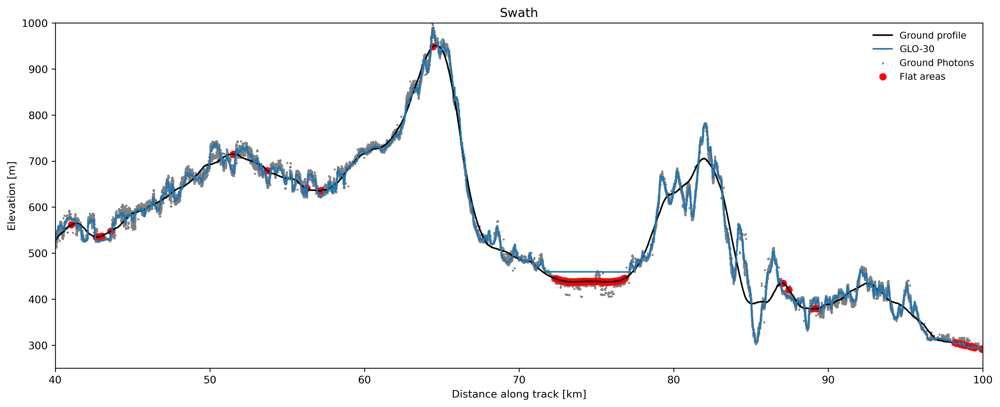

In [13]:
fig, ax = plt.subplots(1,1,figsize=(16,6))
fig.set_dpi(300)
ax.plot(xy[:,0], y2, color='k', label='Ground profile')
ax.plot(gdf.alongtrack_real, gdf.glo30_ell, label='COP-30')
ax.scatter(gdf.alongtrack_real, gdf.Photon_Height, s=1, color='grey', label='Ground Photons')
ax.scatter(x[flat_points], y[flat_points], color='red', label='Flat areas')
plt.axis([40, 100, 250, 1000])
ax.set_title('Swath')
ax.legend(frameon=False, fontsize=9)
ax.set_ylabel('Elevation [m]')
ax.set_xlabel('Distance along track [km]')
#plt.savefig(r'D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\figures\Zoom_DEMs_comparisson.png', bbox_inches='tight')

STATISTICS AND DEVIATIONS

In [13]:
data = {'Longitude': xx[:,3], 'Latitude': xx[:,2], "Height" : xx[:,1], "alongtrack" : xy[:,0] }
df_regression = pd.DataFrame(data)
df_regression["Height"].describe()

count    156980.000000
mean        449.369353
std         167.484651
min         205.728943
25%         291.344627
50%         438.184799
75%         572.158936
max        1001.614258
Name: Height, dtype: float64

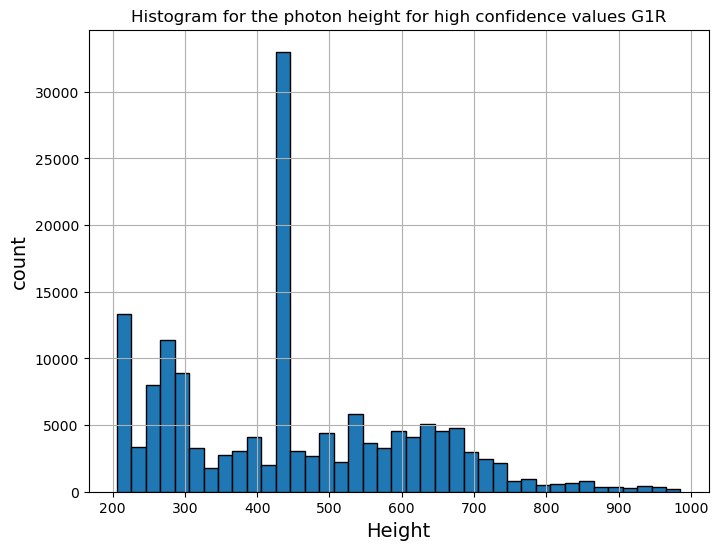

In [74]:
bins = np.arange(df_regression.Height.min(), df_regression.Height.max()+1, 20)

fig, ax1 = plt.subplots(1, 1, figsize=(8, 6))
df_regression.hist('Height', bins=bins, ec='k', lw=1, ax=ax1)
ax1.set_xlabel('Height', fontsize=14)
ax1.set_ylabel('count', fontsize=14)
ax1.set_title("Histogram for the photon height for high confidence values G1R")
#plt.savefig("Histogram for the photon height for high confidence values G1R.jpg");

In [42]:
#extract warm month (May, June, July and August) temperature values 
warm_months = df_regression["Height"].to_numpy(copy=True)


#create ECDF
#a CDF can be generated by ranking the values
ecdf_xvalue = sorted(warm_months)
ecdf_yvalue = np.linspace(0, 1, len(ecdf_xvalue))


#mean and standard deviation of the sample
warm_months_mean = warm_months.mean()
warm_months_sd = warm_months.std()


#CDF for a normal distribution with the same mean and standard deviation of the sample
#range of the sample
x = np.linspace(warm_months.min(), warm_months.max(), 100)

#CDF
dist = stats.norm(loc=warm_months_mean, scale=warm_months_sd)
cdf = dist.cdf(x)


#one-sample ks-test to check normality
ks_test_result = stats.ks_1samp(warm_months, stats.norm.cdf, args=(warm_months_mean, warm_months_sd))

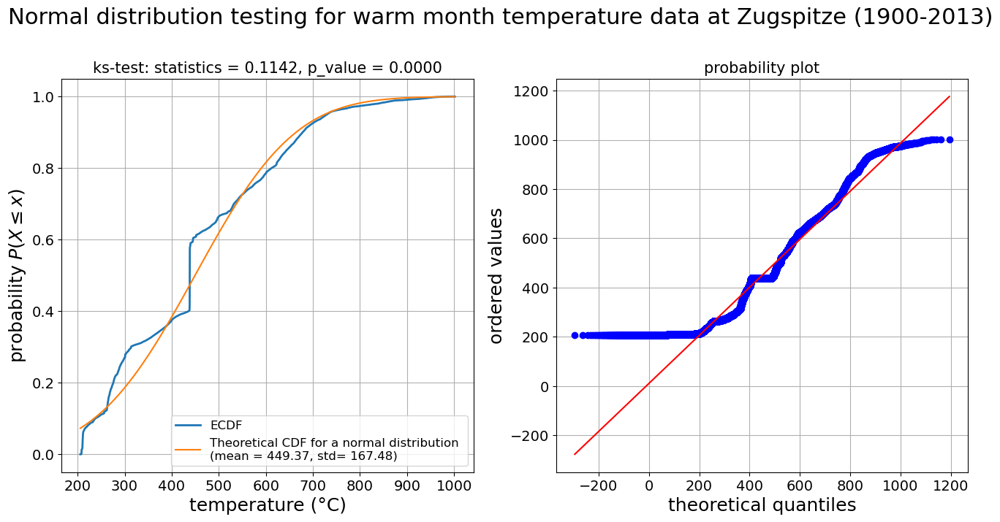

In [32]:
#create a two panel plot
fig, (ax1, ax2) = plt.subplots(nrows= 1, ncols = 2, figsize = (16,7))

#title of the two panel plot
fig.suptitle('Normal distribution testing for warm month temperature data at Zugspitze (1900-2013)', fontsize = 22, y=1.02)


#first panel plot
ax1.plot(ecdf_xvalue, ecdf_yvalue, lw=2,  label='ECDF')
ax1.plot(x, cdf, label = f"Theoretical CDF for a normal distribution \n(mean = {warm_months_mean:.2f}, std= {warm_months_sd:.2f})")
ax1.set_title(f"ks-test: statistics = {ks_test_result[0]:.4f}, p_value = {ks_test_result[1]:.4f}", fontsize = 15)
ax1.set_ylabel("probability $P(X \leq x)$", fontsize=18)
ax1.set_xlabel("temperature (°C)", fontsize=18)
ax1.tick_params(axis='both', which='major', labelsize=14)
ax1.legend(fontsize=12)
ax1.grid()


#second panel plot
#QQ-plot of the sample versus the theoretical distribution
stats.probplot(warm_months, dist=stats.norm, plot=ax2, sparams=(warm_months_mean, warm_months_sd))
ax2.set_title("probability plot",fontsize = 15)
ax2.set_ylabel('ordered values', fontsize=18)
ax2.tick_params(axis='both', which='major', labelsize=14)
ax2.set_xlabel("theoretical quantiles", fontsize=18)
ax2.grid()

In [15]:
temp_tail = abs(x)
# empirical CDF
tail_sorted = sorted(temp_tail)
tail_rank = np.linspace(0, 1, len(tail_sorted))

In [76]:
# calculate the analytical PDF and CDF
x = np.linspace(temp_tail.min(), temp_tail.max(), 100)
pdf_expon = stats.expon.pdf(x, loc=fit_loc, scale=fit_scale)
cdf_expon = stats.expon.cdf(x, loc=fit_loc, scale=fit_scale)

In [77]:
stats.ks_2samp(tail_rank, cdf_expon)

KstestResult(statistic=0.16, pvalue=0.1548386665118475)

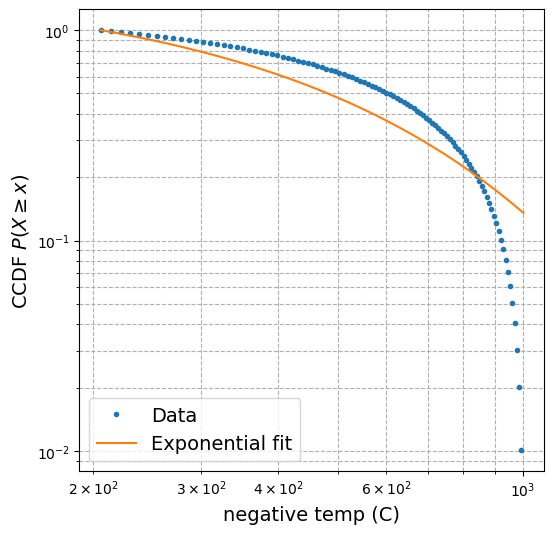

In [62]:
# plot the CCDF for the data and fit
fig, ax1 = plt.subplots(1, 1, figsize=(6, 6))
ax1.loglog(tail_sorted, 1-tail_rank, '.', label='Data')
ax1.loglog(x, 1-cdf_expon, label='Exponential fit')
ax1.set_xlabel('negative temp (C)', fontsize=14)
ax1.set_ylabel('CCDF $P (X \geq x)$', fontsize=14)
ax1.grid(which='both', ls='--')
ax1.legend(fontsize=14);

In [78]:
temp_tail = abs(x)

# use scipy to fit the log normal distribution on our raw data
fit_shape, fit_loc, fit_scale = stats.lognorm.fit(temp_tail)

# calculate the analytical PDF and CDF
x = np.linspace(temp_tail.min(), temp_tail.max(), 100)
pdf_lognorm = stats.lognorm.pdf(x, s=fit_shape, loc=fit_loc, scale=fit_scale)
cdf_lognorm = stats.lognorm.cdf(x, s=fit_shape, loc=fit_loc, scale=fit_scale)

KstestResult(statistic=0.6, pvalue=4.528308394643339e-17)


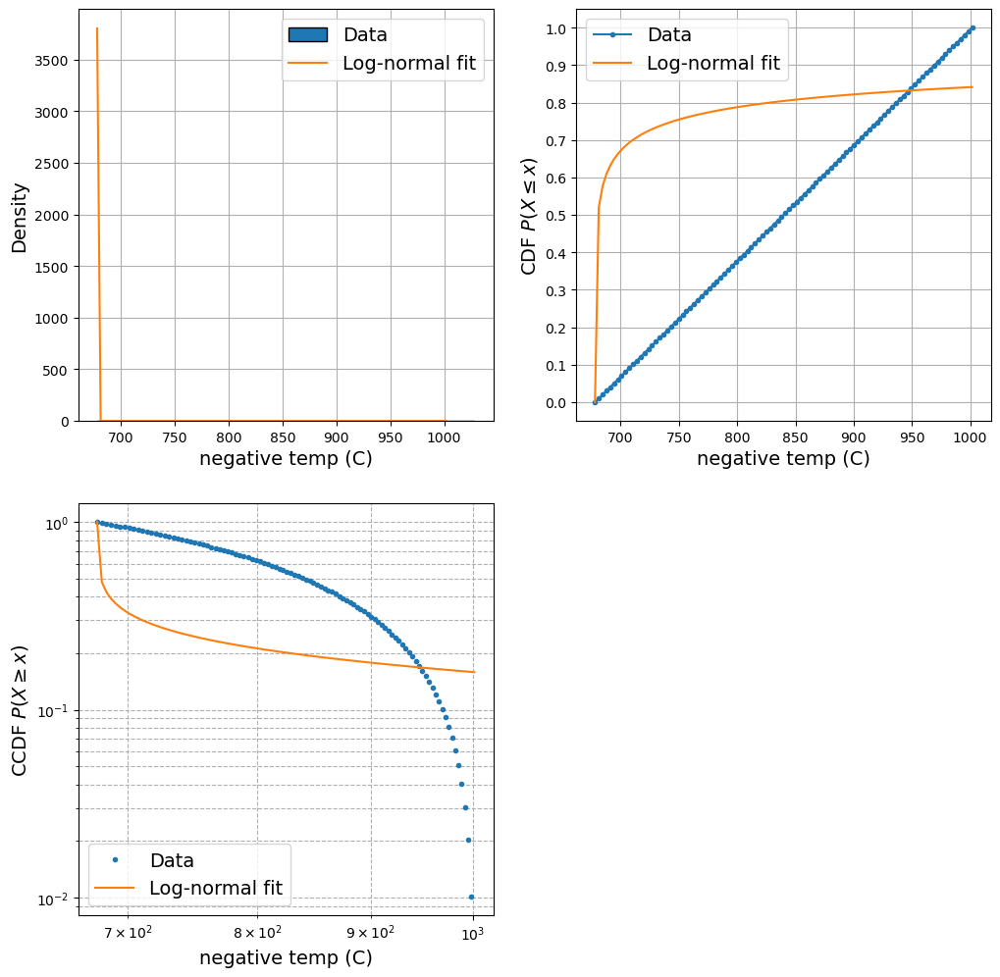

In [79]:
# now plot a histogram, CDF, and CCDF of the result!
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
ax1, ax2, ax3, ax4 = axes.flatten()
# NOTE - we only need three subplots so we just delete the empty one
fig.delaxes(ax4)

# density histogram
ax1.hist(temp_tail, density=True, bins=t_bins, ec='k', label='Data')
ax1.plot(x, pdf_lognorm, label='Log-normal fit')
ax1.set_xlabel('negative temp (C)', fontsize=14)
ax1.set_ylabel('Density', fontsize=14)
ax1.legend(fontsize=14)
ax1.grid()

# empirical CDF
ax2.plot(tail_sorted, tail_rank, '.-', label='Data')
ax2.plot(x, cdf_lognorm, label='Log-normal fit')
ax2.set_xlabel('negative temp (C)', fontsize=14)
ax2.set_ylabel('CDF $P (X \leq x)$', fontsize=14)
ax2.set_yticks(np.arange(0, 1.1, 0.1))
ax2.legend(fontsize=14)
ax2.grid()

# CCDF
ax3.loglog(tail_sorted, 1-tail_rank, '.', label='Data')
ax3.loglog(x, 1-cdf_lognorm, label='Log-normal fit')
ax3.set_xlabel('negative temp (C)', fontsize=14)
ax3.set_ylabel('CCDF $P (X \geq x)$', fontsize=14)
ax3.grid(which='both', ls='--')
ax3.legend(fontsize=14);

# and the 2 sample ks-test
print(stats.ks_2samp(tail_rank, cdf_lognorm))

KstestResult(statistic=0.06, pvalue=0.9942356257694902)


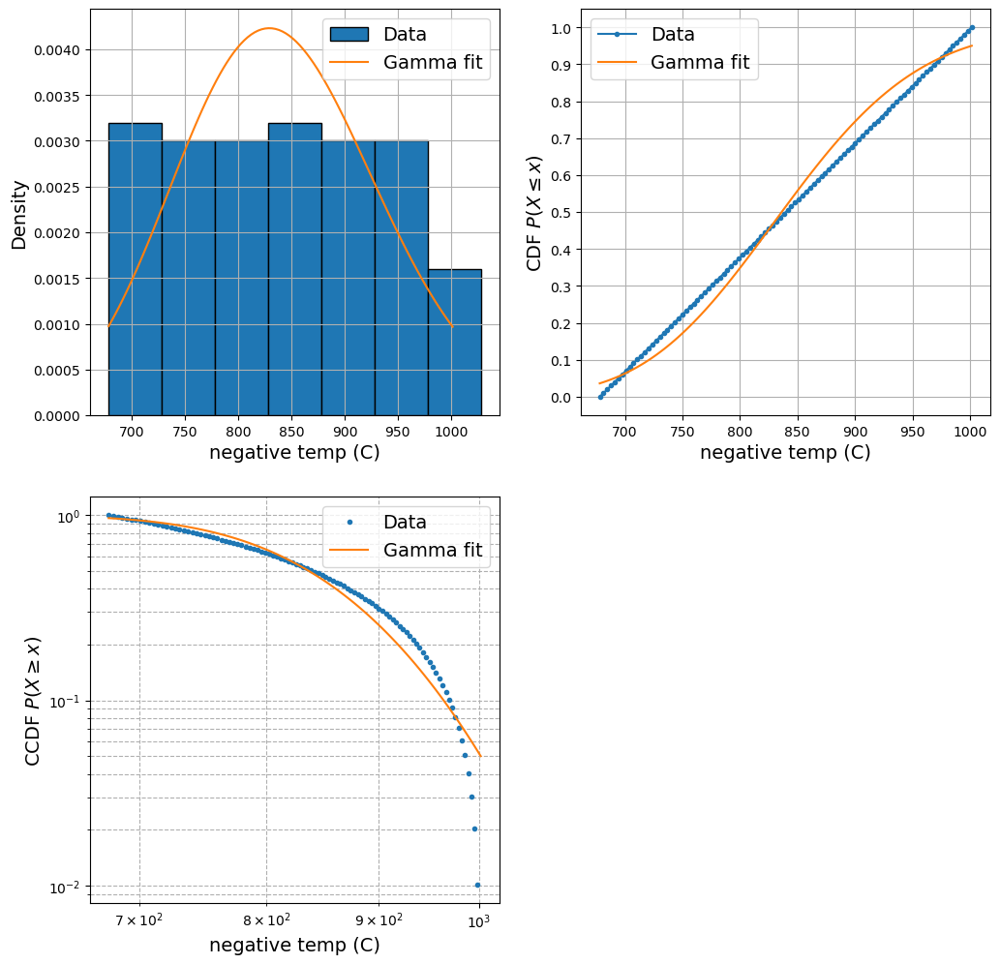

In [80]:
temp_tail = abs(x)
# use scipy to fit the log normal distribution on our raw data
fit_shape, fit_loc, fit_scale = stats.gamma.fit(temp_tail, floc=0) # NOTE - fixed location

# calculate the analytical PDF and CDF
x = np.linspace(temp_tail.min(), temp_tail.max(), 100)
pdf_gamma = stats.gamma.pdf(x, a=fit_shape, loc=fit_loc, scale=fit_scale)
cdf_gamma = stats.gamma.cdf(x, a=fit_shape, loc=fit_loc, scale=fit_scale)

# Let's put all the information into one three panel plot and print the ks-test result.

# now plot a histogram, CDF, and CCDF of the result!
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
ax1, ax2, ax3, ax4 = axes.flatten()
# NOTE - we only need three subplots so we just delete the empty one
fig.delaxes(ax4)

# density histogram
ax1.hist(temp_tail, density=True, bins=t_bins, ec='k', label='Data')
ax1.plot(x, pdf_gamma, label='Gamma fit')
ax1.set_xlabel('negative temp (C)', fontsize=14)
ax1.set_ylabel('Density', fontsize=14)
ax1.legend(fontsize=14)
ax1.grid()

# empirical CDF
ax2.plot(tail_sorted, tail_rank, '.-', label='Data')
ax2.plot(x, cdf_gamma, label='Gamma fit')
ax2.set_xlabel('negative temp (C)', fontsize=14)
ax2.set_ylabel('CDF $P (X \leq x)$', fontsize=14)
ax2.set_yticks(np.arange(0, 1.1, 0.1))
ax2.legend(fontsize=14)
ax2.grid()

# CCDF
ax3.loglog(tail_sorted, 1-tail_rank, '.', label='Data')
ax3.loglog(x, 1-cdf_gamma, label='Gamma fit')
ax3.set_xlabel('negative temp (C)', fontsize=14)
ax3.set_ylabel('CCDF $P (X \geq x)$', fontsize=14)
ax3.grid(which='both', ls='--')
ax3.legend(fontsize=14);

# and the 2 sample ks-test
print(stats.ks_2samp(tail_rank, cdf_gamma))

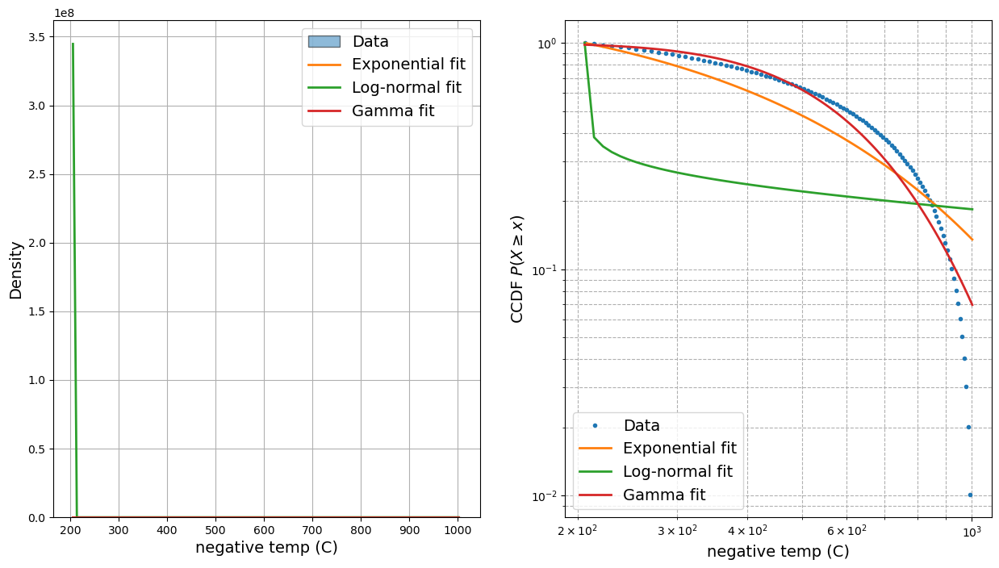

In [66]:
# now plot a histogram, CDF, and CCDF of the result!
fig, axes = plt.subplots(1, 2, figsize=(15, 8))
ax1, ax2 = axes.flatten()

# density histogram
ax1.hist(temp_tail, density=True, bins=t_bins, alpha=0.5, ec='k', label='Data')
ax1.plot(x, pdf_expon, lw=2, label='Exponential fit')
ax1.plot(x, pdf_lognorm, lw=2, label='Log-normal fit')
ax1.plot(x, pdf_gamma, lw=2, label='Gamma fit')
ax1.set_xlabel('negative temp (C)', fontsize=14)
ax1.set_ylabel('Density', fontsize=14)
ax1.legend(fontsize=14)
ax1.grid()

# CCDF
ax2.loglog(tail_sorted, 1-tail_rank, '.', label='Data')
ax2.loglog(x, 1-cdf_expon, lw=2, label='Exponential fit')
ax2.loglog(x, 1-cdf_lognorm, lw=2, label='Log-normal fit')
ax2.loglog(x, 1-cdf_gamma, lw=2, label='Gamma fit')
ax2.set_xlabel('negative temp (C)', fontsize=14)
ax2.set_ylabel('CCDF $P (X \geq x)$', fontsize=14)
ax2.grid(which='both', ls='--')
ax2.legend(fontsize=14)

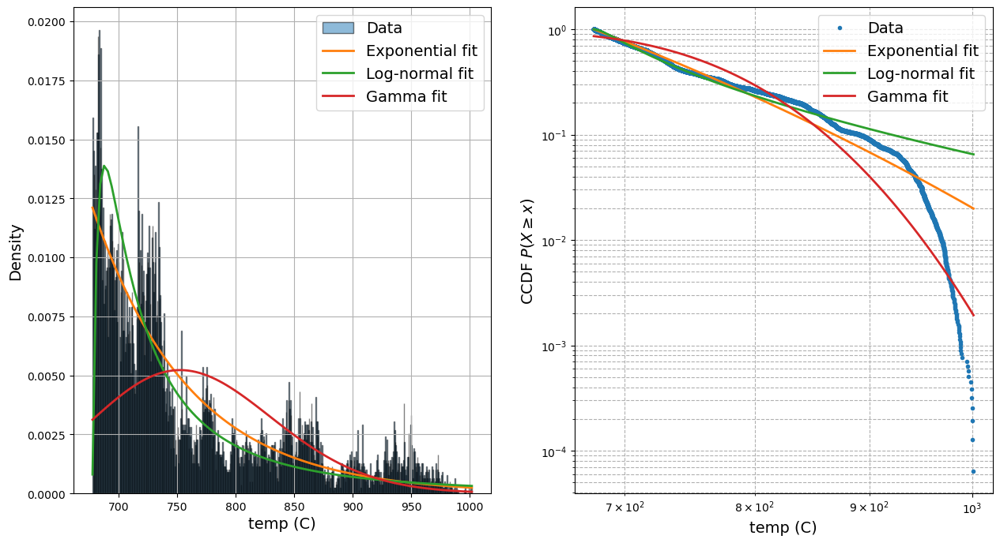

In [70]:
# threshold with this value
temp_tail = df_regression["Height"][df_regression["Height"] > np.percentile(df_regression["Height"], 90)]
t_bins = np.arange(temp_tail.min(), temp_tail.max()+0.5, 0.5)
tail_sorted = sorted(temp_tail)
tail_rank = np.linspace(0, 1, len(tail_sorted))

# do the fits
x = np.linspace(temp_tail.min(), temp_tail.max(), 100)
fit_loc, fit_scale = stats.expon.fit(temp_tail)
pdf_expon = stats.expon.pdf(x, loc=fit_loc, scale=fit_scale)
cdf_expon = stats.expon.cdf(x, loc=fit_loc, scale=fit_scale)

fit_shape, fit_loc, fit_scale = stats.lognorm.fit(temp_tail)
pdf_lognorm = stats.lognorm.pdf(x, s=fit_shape, loc=fit_loc, scale=fit_scale)
cdf_lognorm = stats.lognorm.cdf(x, s=fit_shape, loc=fit_loc, scale=fit_scale)

fit_shape, fit_loc, fit_scale = stats.gamma.fit(temp_tail, floc=18) # NOTE - fixed location
pdf_gamma = stats.gamma.pdf(x, a=fit_shape, loc=fit_loc, scale=fit_scale)
cdf_gamma = stats.gamma.cdf(x, a=fit_shape, loc=fit_loc, scale=fit_scale)

# now plot a histogram, CDF, and CCDF of the result!
fig, axes = plt.subplots(1, 2, figsize=(15, 8))
ax1, ax2 = axes.flatten()

# density histogram
ax1.hist(temp_tail, density=True, bins=t_bins, alpha=0.5, ec='k', label='Data')
ax1.plot(x, pdf_expon, lw=2, label='Exponential fit')
ax1.plot(x, pdf_lognorm, lw=2, label='Log-normal fit')
ax1.plot(x, pdf_gamma, lw=2, label='Gamma fit')
ax1.set_xlabel('temp (C)', fontsize=14)
ax1.set_ylabel('Density', fontsize=14)
ax1.legend(fontsize=14)
ax1.grid()

# CCDF
ax2.loglog(tail_sorted, 1-tail_rank, '.', label='Data')
ax2.loglog(x, 1-cdf_expon, lw=2, label='Exponential fit')
ax2.loglog(x, 1-cdf_lognorm, lw=2, label='Log-normal fit')
ax2.loglog(x, 1-cdf_gamma, lw=2, label='Gamma fit')
ax2.set_xlabel('temp (C)', fontsize=14)
ax2.set_ylabel('CCDF $P (X \geq x)$', fontsize=14)
ax2.grid(which='both', ls='--')
ax2.legend(fontsize=14)

In [87]:
temp_tail = abs(y2 - gdf.glo30_ell)

# use scipy to fit the log normal distribution on our raw data
fit_shape, fit_loc, fit_scale = stats.lognorm.fit(temp_tail)

# calculate the analytical PDF and CDF
x = np.linspace(temp_tail.min(), temp_tail.max(), 100)
pdf_lognorm = stats.lognorm.pdf(x, s=fit_shape, loc=fit_loc, scale=fit_scale)
cdf_lognorm = stats.lognorm.cdf(x, s=fit_shape, loc=fit_loc, scale=fit_scale)
print(stats.ks_2samp(tail_rank, cdf_lognorm))

KstestResult(statistic=0.77, pvalue=1.923609841119e-29)


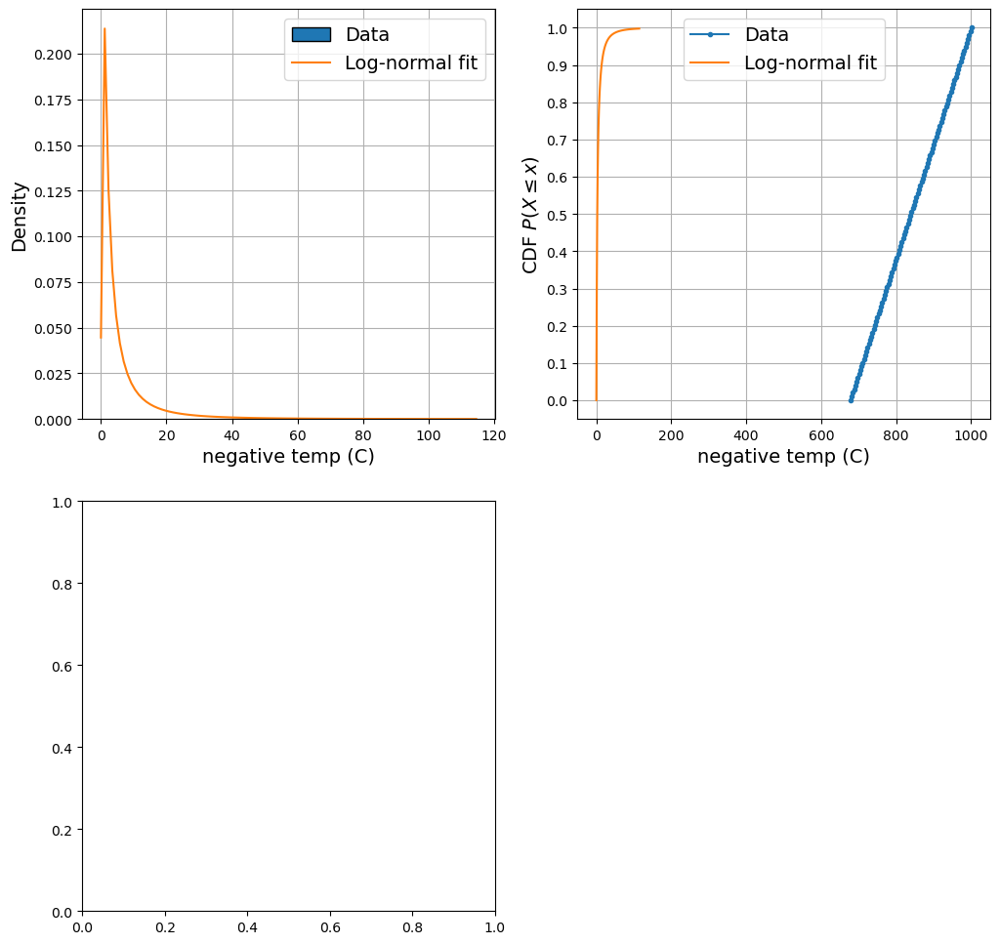

In [89]:
# now plot a histogram, CDF, and CCDF of the result!
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
ax1, ax2, ax3, ax4 = axes.flatten()
# NOTE - we only need three subplots so we just delete the empty one
fig.delaxes(ax4)

# density histogram
ax1.hist(temp_tail, density=True, bins=t_bins, ec='k', label='Data')
ax1.plot(x, pdf_lognorm, label='Log-normal fit')
ax1.set_xlabel('negative temp (C)', fontsize=14)
ax1.set_ylabel('Density', fontsize=14)
ax1.legend(fontsize=14)
ax1.grid()

# empirical CDF
ax2.plot(tail_sorted, tail_rank, '.-', label='Data')
ax2.plot(x, cdf_lognorm, label='Log-normal fit')
ax2.set_xlabel('negative temp (C)', fontsize=14)
ax2.set_ylabel('CDF $P (X \leq x)$', fontsize=14)
ax2.set_yticks(np.arange(0, 1.1, 0.1))
ax2.legend(fontsize=14)
ax2.grid()


GEOLOGY PROFILE

In [102]:
geo_gdf = gpd.read_file(r"D:\Datos de Usuario\Univ\Semester_4\Internship_thesis\Qgis\shapefiles\geology_clipped.shp")
geo_gdf

,AREA,PERIMETER,GEO8AG_,GEO8AG_ID,GLG,geometry
0,1.139,18.949,635,1262,pC,"POLYGON ((76.83018 32.14875, 76.83062 32.14742..."
1,1.083,21.749,643,1331,Trms,"POLYGON ((77.51578 32.15319, 77.51649 32.15114..."
2,0.636,4.910,660,1339,pC,"POLYGON ((77.27879 32.15165, 77.28250 32.14021..."
3,0.115,3.507,785,1483,Pz,"POLYGON ((77.58379 32.15363, 77.58692 32.14615..."
4,2.919,22.561,862,1450,Q,"POLYGON ((75.39580 32.13948, 75.39456 32.13780..."
5,0.119,3.168,954,1602,pC,"MULTIPOLYGON (((76.10403 32.14406, 76.10684 32..."
6,0.071,3.095,961,1605,Pz,"POLYGON ((76.03595 32.14362, 76.04088 32.13878..."
7,0.213,5.159,969,1609,N,"POLYGON ((75.86447 32.14251, 75.86560 32.13504..."
8,0.543,7.384,978,1630,pC,"POLYGON ((76.28725 32.14524, 76.29561 32.13863..."
9,0.015,0.752,984,1621,Ts,"POLYGON ((75.80735 32.14214, 75.80852 32.13860..."


In [82]:
# iterate over the list of dataframes

# create a GeoDataFrame from the dataframe
gdf = gp.GeoDataFrame(xy, geometry=gp.points_from_xy(ATL03_list[21].Longitude, ATL03_list[21].Latitude))
    
# set the output file name
out_file = f"beam.shp"
    
# save the GeoDataFrame to a shapefile
warnings.simplefilter('ignore', category=UserWarning)
gdf.to_file(out_file, driver='ESRI Shapefile')

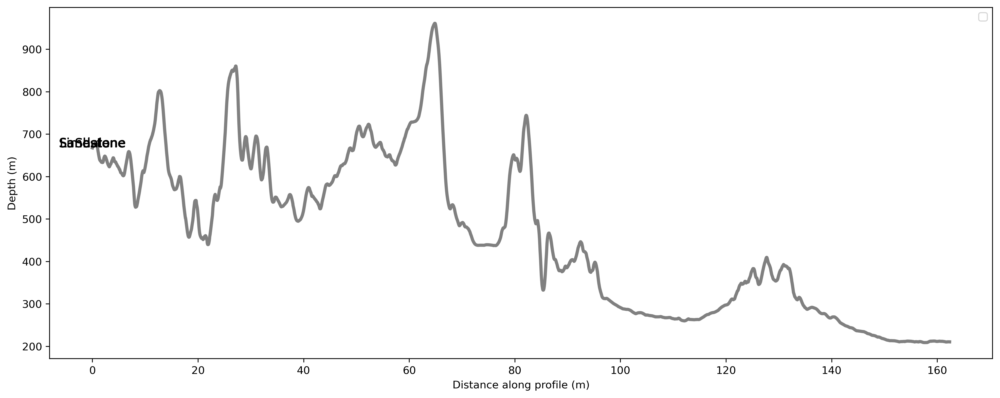

In [99]:
# Generate a sample topographic curve
x = xy[:,0]
y = y2

# Calculate the slope at each point on the curve using numerical differentiation
dx = x[1] - x[0]
dydx = np.gradient(y, dx)

# Identify points where the slope is close to 0
tolerance = 0.001
flat_points = np.where(np.abs(dydx) < tolerance)[0]

layers = ['Sandstone', 'Shale', 'Limestone', 'Sandstone', 'Shale', 'Limestone',
          'Sandstone', 'Shale', 'Limestone', 'Sandstone']

# Plot the results
fig, ax = plt.subplots(figsize=(16,6))
fig.set_dpi(300)
ax.plot(x, y, color='gray', linewidth=3)
for i in range(len(layers)):
    ax.text(x[i], y[i]+2, layers[i], fontsize=12, ha='center')
#ax.scatter(x[flat_points], y[flat_points], color='red', label='Flat areas')
ax.set_xlabel('Distance along profile (m)')
ax.set_ylabel('Depth (km)')
ax.legend()

#plt.axis([40, 100, 250, 1000])
#plt.savefig("Zoom areas with slope 0.001.png")
plt.show()

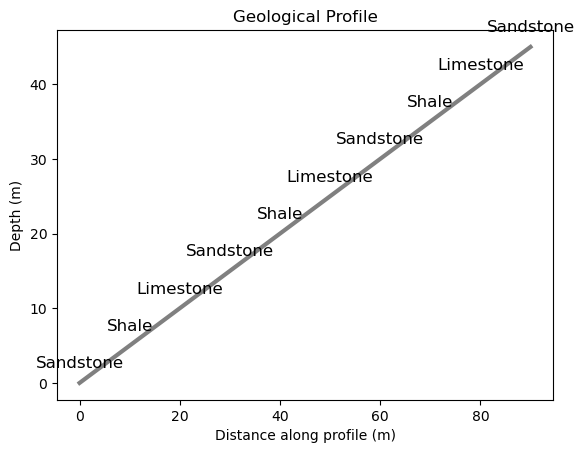

In [87]:
import matplotlib.pyplot as plt

# Define the coordinates along the profile
x = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90]
y = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45]

# Define the geological layers along the profile
layers = ['Sandstone', 'Shale', 'Limestone', 'Sandstone', 'Shale', 'Limestone',
          'Sandstone', 'Shale', 'Limestone', 'Sandstone']

# Create a figure and axis object
fig, ax = plt.subplots()

# Plot the geological layers
ax.plot(x, y, color='gray', linewidth=3)

# Add labels for the geological layers
for i in range(len(layers)):
    ax.text(x[i], y[i]+2, layers[i], fontsize=12, ha='center')

# Add axis labels and title
ax.set_xlabel('Distance along profile (m)')
ax.set_ylabel('Depth (m)')
ax.set_title('Geological Profile')

# Display the plot
plt.show()
